# Project 1
## In this project i will create a ML logistic regression Model in which i will perform Data cleaning, preprocessing, regularization technic

In [2]:
# importing the required packages
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

In [3]:
# import dataset
dataset = pd.read_csv('synthetic_classification_dataset.csv')
dataset.head(3)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,target
0,0.442482,0.496370,NaN,3.993996,-1.626709,NaN,-2.640725,2.155101,-0.044975,-2.928344,...,-9.638219,0.829099,-0.906175,-3.941275,3.914459,2.196404,1.758586,0.270454,4.157829,0
1,3.792045,-1.238809,2.384548,-3.041412,-0.183533,11.426559,0.352230,-3.926647,-4.786749,1.681911,...,7.240970,-0.426583,-0.491798,2.931648,1.171112,3.207847,1.116246,-2.203911,-0.471477,0
2,-0.164392,0.287535,-2.347131,-1.198061,-1.699967,-0.694042,-1.170776,-2.222280,-0.304455,-0.578182,...,6.851054,-0.047428,0.576033,0.416011,-1.570707,4.130764,0.646708,-1.319033,-1.082807,1


In [5]:
#now describe/info the dataset
dataset.describe(), dataset.info


(         feature_0    feature_1    feature_2    feature_3    feature_4  \
 count  2000.000000  2000.000000  1966.000000  2000.000000  2000.000000   
 mean      0.460748     0.004131     0.009361     0.073308    -0.477231   
 std       2.276473     1.017789     2.395210     2.613154     2.272606   
 min      -6.594444    -4.186148    -7.709899    -9.391110    -8.465842   
 25%      -1.087436    -0.709011    -1.604169    -1.707505    -2.024308   
 50%       0.489718    -0.004585    -0.113372    -0.045131    -0.527213   
 75%       1.961759     0.706776     1.562734     1.777575     0.901604   
 max       8.351587     4.298858     8.497860     7.973154     8.984684   
 
          feature_5    feature_6    feature_7    feature_8    feature_9  ...  \
 count  1973.000000  2000.000000  2000.000000  2000.000000  2000.000000  ...   
 mean     -0.002812    -0.497282    -0.031289     0.535641    -0.481527  ...   
 std       4.452158     2.538503     2.329090     2.489788     2.346598  ...   
 mi

In [6]:
# now check the null values
dataset.isnull().sum()

feature_0      0
feature_1      0
feature_2     34
feature_3      0
feature_4      0
feature_5     27
feature_6      0
feature_7      0
feature_8      0
feature_9      0
feature_10    23
feature_11     0
feature_12     0
feature_13     0
feature_14     0
feature_15     0
feature_16     0
feature_17     0
feature_18     0
feature_19     0
feature_20     0
feature_21     0
feature_22     0
feature_23     0
feature_24     0
target         0
dtype: int64

In [7]:
# now fill the null values or delete them, im using fillna with mean
dataset['feature_2'].fillna(dataset['feature_2'].mean(),inplace=True)

dataset['feature_5'].fillna(dataset['feature_5'].mean(),inplace=True)

dataset['feature_10'].fillna(dataset['feature_10'].mean(),inplace=True)

C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1501416191.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  dataset['feature_2'].fillna(dataset['feature_2'].mean(),inplace=True)
C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1501416191.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always 

In [8]:
# now verify the dataset for null
dataset.isnull().sum()

feature_0     0
feature_1     0
feature_2     0
feature_3     0
feature_4     0
feature_5     0
feature_6     0
feature_7     0
feature_8     0
feature_9     0
feature_10    0
feature_11    0
feature_12    0
feature_13    0
feature_14    0
feature_15    0
feature_16    0
feature_17    0
feature_18    0
feature_19    0
feature_20    0
feature_21    0
feature_22    0
feature_23    0
feature_24    0
target        0
dtype: int64

### This dataset not required the encoding because all data are in integer formate

## Finding the Outliers

In [10]:
#first check the data with graph boxplot

#first delete the target column for outlier visulization
features = dataset.drop('target', axis=1)

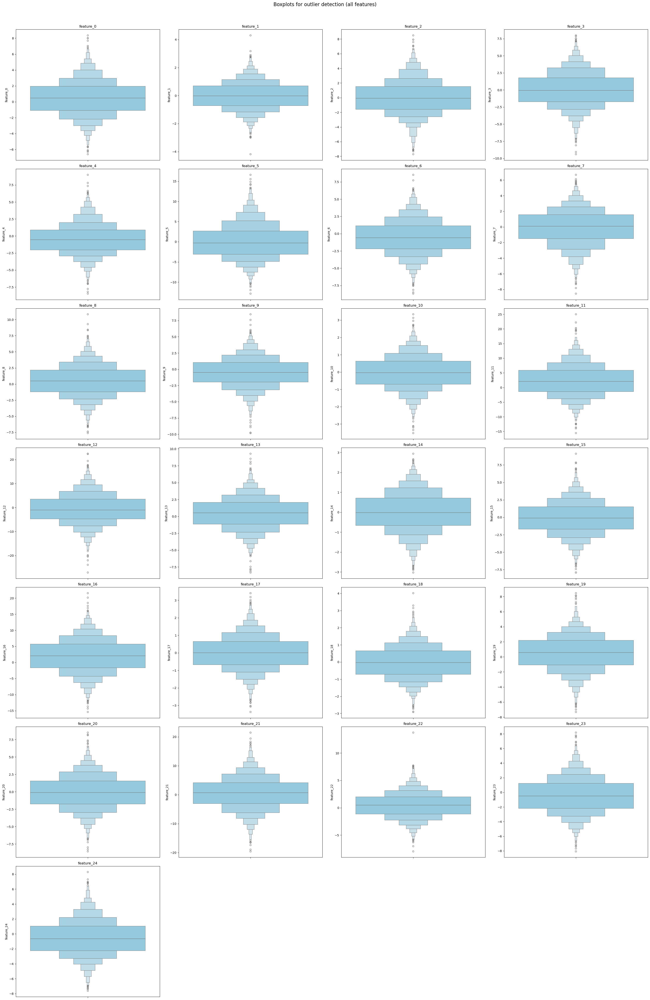

In [18]:
# plot the graph for all the features so we could see the outliers

plt.figure(figsize=(30,45))

# create boxplot for all the features
for i, col in enumerate(features.columns):
    plt.subplot(7, 4, i+1) # 7 rows and 4 columns
    sns.boxenplot(y=features[col], color='skyblue')
    plt.title(col)
    plt.tight_layout()

plt.suptitle('Boxplots for outlier detection (all features)', y=1.02, fontsize=16)
plt.show()

## There are outliers in all the features, now remove all the outliers using IQR methods

In [20]:
# checking the dataset shape
dataset.shape

(2000, 26)

In [24]:

for i, col in enumerate(features.columns):

    # get the first and third quantile for IQR
    q1 = dataset[col].quantile(0.25)
    q3 = dataset[col].quantile(0.75)

    IQR = q3 -q1

    # getting the min and max range

    min_range = q1 - (1.5 * IQR)
    max_range = q3 + (1.5 * IQR)

    # now removing the outliers and create a new dataset

    dataset = dataset[(dataset[col] >= min_range) & (dataset[col] <= max_range)]

dataset.reset_index(drop=True, inplace=True)
dataset.shape

# there is change in dataset now there is 1628 rows are deleted those are outliers. 374 Outliers.


(1565, 26)

## Feature Scaling

In [25]:
# check the dataset for scaling
dataset.describe()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,target
count,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,...,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000
mean,0.314157,-0.010083,-0.109952,-0.022859,-0.587975,-0.315596,-0.517244,0.146014,0.587701,-0.396206,...,2.069952,0.013442,-0.027015,0.511363,-0.157017,0.434665,0.437448,-0.415568,-0.583581,0.504792
std,2.109937,0.985119,2.068235,2.418951,2.062045,3.916599,2.290319,2.107170,2.271937,2.140710,...,5.039566,0.933351,0.946273,2.168623,2.299547,4.889784,2.161620,2.307887,2.300570,0.500137
min,-5.341385,-2.741212,-5.657119,-6.397146,-6.343377,-11.168384,-6.828784,-5.509839,-5.633479,-6.033337,...,-11.466472,-2.524265,-2.666488,-5.297787,-6.320462,-12.824538,-5.389019,-6.448029,-7.001247,0.000000
25%,-1.139353,-0.711629,-1.560769,-1.726893,-2.045753,-3.100193,-2.100123,-1.225690,-1.031524,-1.792719,...,-1.312062,-0.643254,-0.712365,-0.995593,-1.763110,-2.933207,-1.055769,-2.051370,-2.207744,0.000000
50%,0.377427,-0.024145,-0.138964,-0.109949,-0.577506,-0.494234,-0.607223,0.219980,0.552879,-0.405365,...,2.064130,0.020031,-0.028753,0.571386,-0.166762,0.559573,0.490143,-0.455436,-0.662284,1.000000
75%,1.762817,0.692884,1.257374,1.564809,0.819488,2.279635,1.054870,1.597775,2.116589,1.054830,...,5.511968,0.636179,0.643305,2.057142,1.384579,3.689299,1.881927,1.192598,1.009464,1.000000
max,6.179239,2.780202,5.503352,6.477019,5.064738,10.357726,5.879161,5.731708,6.761782,5.323527,...,15.701150,2.525588,2.623185,6.484686,6.112233,13.154875,6.107746,6.048563,5.836688,1.000000


C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\2408983785.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\2408983785.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Tem

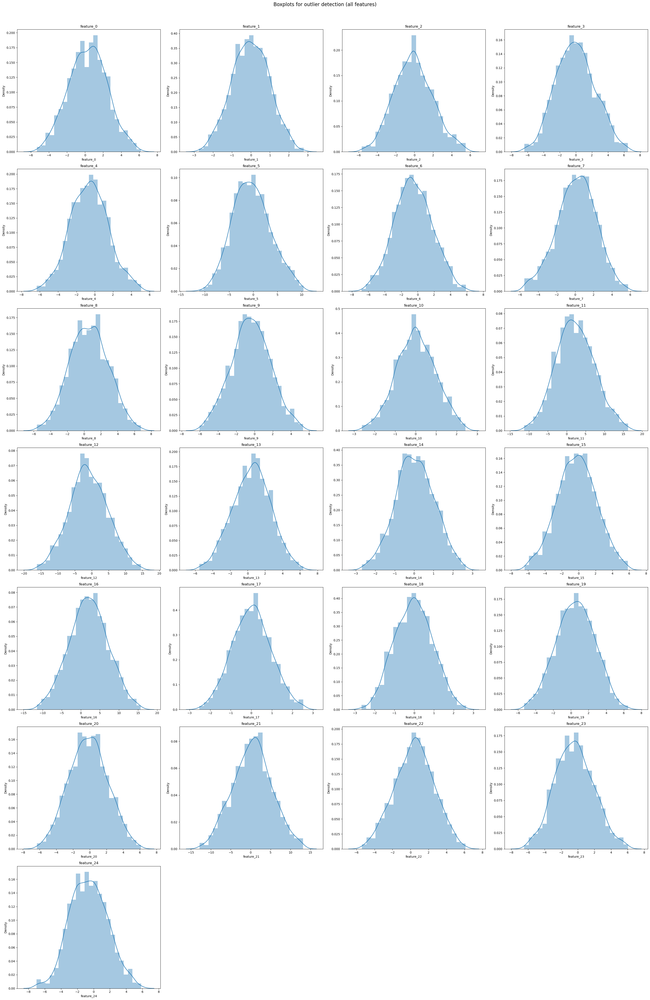

In [26]:
# now plot the graph using distplot

plt.figure(figsize=(30,45))

# create boxplot for all the features
for i, col in enumerate(features.columns):
    plt.subplot(7, 4, i+1) # 7 rows and 4 columns
    sns.distplot(dataset[col])
    plt.title(col)
    plt.tight_layout()

plt.suptitle('Boxplots for outlier detection (all features)', y=1.02, fontsize=16)
plt.show()

In [ ]:
# feature scaling, you could use minmax scaling

ss = StandardScaler()

for i, col in enumerate(features.columns):
    dataset[col] = ss.fit_transform(dataset[[col]])



C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1326855045.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1326855045.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Tem

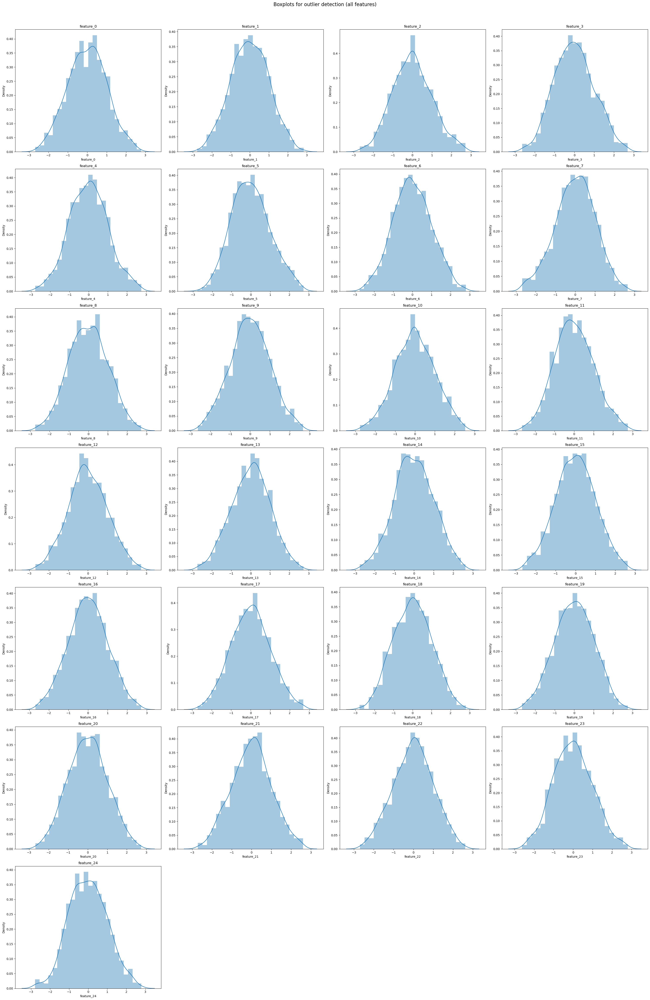

In [30]:
# now check the graph again after scaling, you could clearly see the difference 

plt.figure(figsize=(30,45))

# create boxplot for all the features
for i, col in enumerate(features.columns):
    plt.subplot(7, 4, i+1) # 7 rows and 4 columns
    sns.distplot(dataset[col])
    plt.title(col)
    plt.tight_layout()

plt.suptitle('Boxplots for outlier detection (all features)', y=1.02, fontsize=16)
plt.show()

## Data Transformation.
### Here no need of any data transformation 

In [31]:
## blank 

## Function Transformation

In [32]:
from sklearn.preprocessing import FunctionTransformer
import numpy as np

ft = FunctionTransformer(func=np.log1p)

In [33]:
# now transform the function for data distribution and scaling so it properly fit in model

for i, col in enumerate(features.columns):
    dataset[col] = ft.fit_transform(dataset[[col]])

d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
d:\anaconda3\Lib\site-packages\pandas\core\internals

C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1655520776.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Temp\ipykernel_3836\1655520776.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(dataset[col])
C:\Users\Jeetendra\AppData\Local\Tem

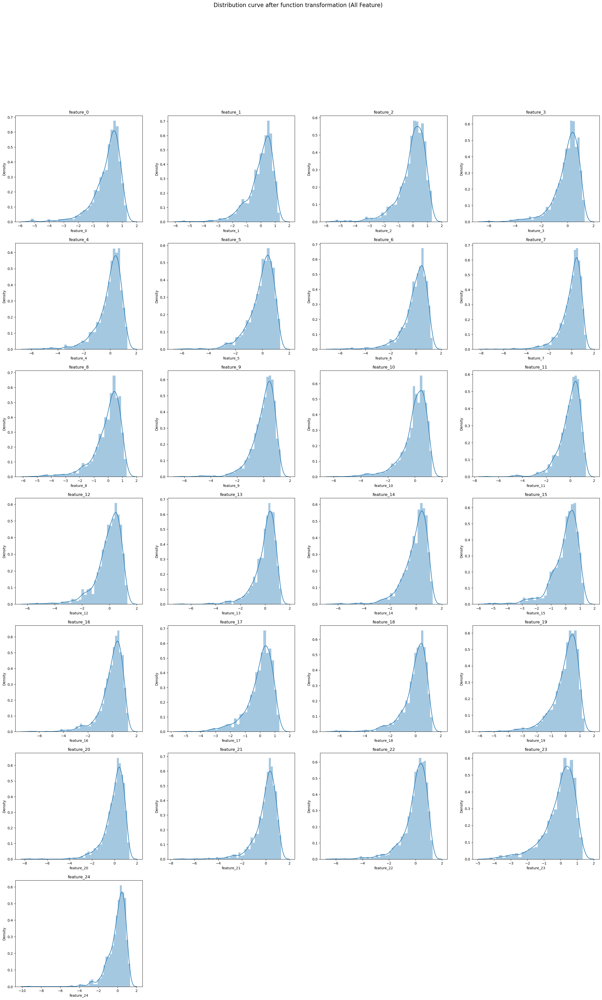

In [ ]:
# now check the distribution curve of the features, you could compare the above and this graph

plt.figure(figsize=(30,45))

for i, col in enumerate(features.columns):
    plt.subplot(7,4, i + 1)
    sns.distplot(dataset[col])
    plt.title(col)

plt.suptitle('Distribution curve after function transformation (All Feature)', fontsize=16)
plt.show()

## Feature Selection
### using forward feature selection

In [38]:
from mlxtend.feature_selection import SequentialFeatureSelector

In [59]:
# check null value in dataset again after all processes
dataset.isnull().sum()

feature_0     262
feature_1     259
feature_2     255
feature_3     260
feature_4     247
feature_5     254
feature_6     253
feature_7     245
feature_8     253
feature_9     260
feature_10    248
feature_11    258
feature_12    239
feature_13    268
feature_14    239
feature_15    251
feature_16    245
feature_17    257
feature_18    260
feature_19    257
feature_20    267
feature_21    257
feature_22    259
feature_23    253
feature_24    260
target          0
dtype: int64

In [61]:
#now fill all the null values

for i, col in enumerate(features.columns):
    dataset[col] = dataset[col].fillna(dataset[col].mean())

# check the null again
dataset.isnull().sum()

feature_0     0
feature_1     0
feature_2     0
feature_3     0
feature_4     0
feature_5     0
feature_6     0
feature_7     0
feature_8     0
feature_9     0
feature_10    0
feature_11    0
feature_12    0
feature_13    0
feature_14    0
feature_15    0
feature_16    0
feature_17    0
feature_18    0
feature_19    0
feature_20    0
feature_21    0
feature_22    0
feature_23    0
feature_24    0
target        0
dtype: int64

In [62]:
# input and output variable selection

x = dataset.iloc[:, :-1]
y = dataset['target']



In [63]:
# logistic regression declaration
lr = LogisticRegression()

In [64]:
# use feature selection
fs = SequentialFeatureSelector(lr, k_features=features.shape[1], forward=True)
fs.fit(x, y)
fs.k_score_

0.7073482428115015

In [65]:
# get the required features names
fs.k_feature_names_

('feature_0',
 'feature_1',
 'feature_2',
 'feature_3',
 'feature_4',
 'feature_5',
 'feature_6',
 'feature_7',
 'feature_8',
 'feature_9',
 'feature_10',
 'feature_11',
 'feature_12',
 'feature_13',
 'feature_14',
 'feature_15',
 'feature_16',
 'feature_17',
 'feature_18',
 'feature_19',
 'feature_20',
 'feature_21',
 'feature_22',
 'feature_23',
 'feature_24')

## Apply Logistic Regression

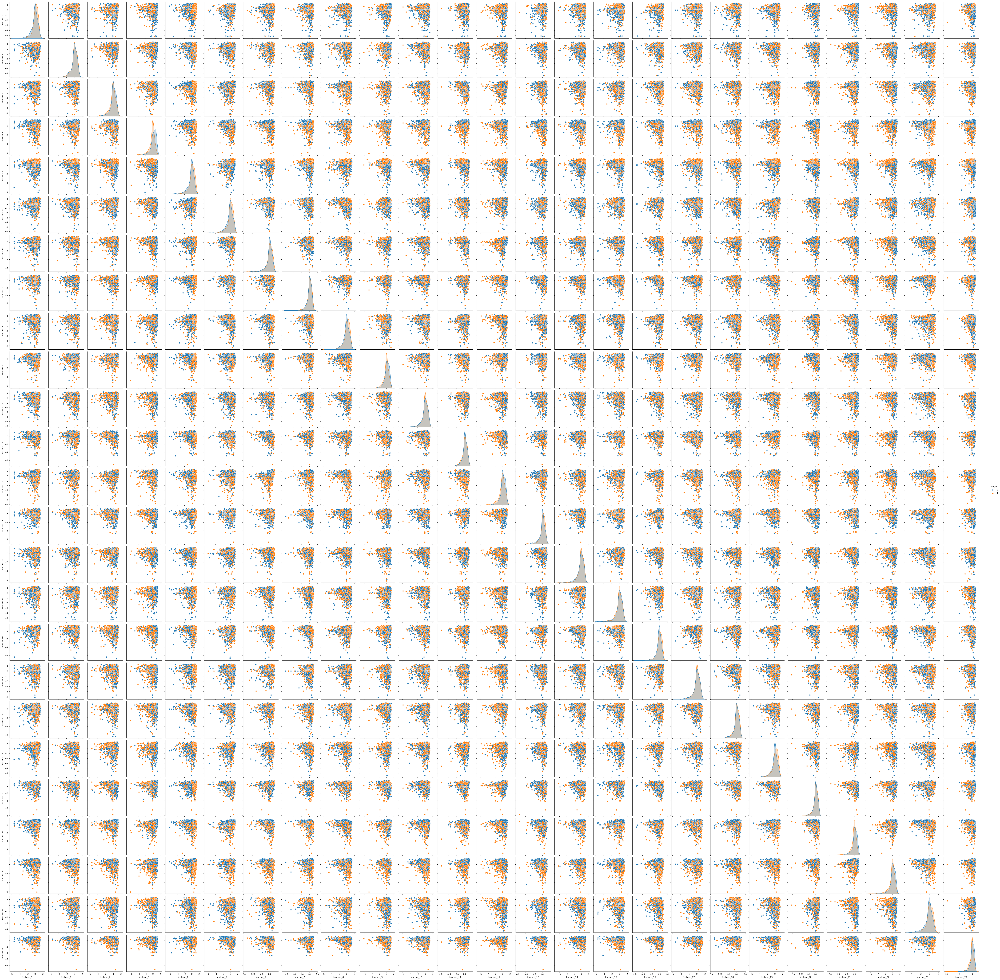

In [80]:
# check the relationship
sns.pairplot(data=dataset, hue="target")
plt.show()

In [75]:
# train test and split data

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=34)

In [76]:
# prepare and train the model

lr.fit(x_train, y_train)

LogisticRegression()

In [77]:
# check the accuracy 
lr.score(x_test, y_test)

0.7220447284345048

In [82]:
# now predict using any value --> 0.44248202771419165,0.49636975617957446,,3.9939960809658754,-1.6267088276635833,,-2.6407248923911695,2.1551005135920143,-0.044974684670257004,-2.928344325317423,,5.083215791549654,1.6452354727361442,-3.445118170892903,-2.2808329873883673,0.2527733128465761,-9.638219406798623,0.8290993374835406,-0.9061754462120633,-3.941274550139129,3.914459318530539,2.196404119027947,1.7585864887304847,0.2704537656256092,4.157828884079284,0

dataset.head(5)

lr.predict([[0.44248202771419165,0.49636975617957446,0,3.9939960809658754,-1.6267088276635833,0,-2.6407248923911695,2.1551005135920143,-0.044974684670257004,-2.928344325317423,0,5.083215791549654,1.6452354727361442,-3.445118170892903,-2.2808329873883673,0.2527733128465761,-9.638219406798623,0.8290993374835406,-0.9061754462120633,-3.941274550139129,3.914459318530539,2.196404119027947,1.7585864887304847,0.2704537656256092,4.157828884079284]])

d:\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


array([0], dtype=int64)

In [ ]:
dataset.head(5)

lr.predict([dataset.iloc[4,:-1]]) 

# it predicting fine

d:\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


array([1], dtype=int64)